### Joelle Hyunseo Cho 014513460 
# Math 185 Project 
> ## Body Performance Based on Physical Condition 


### Abstract 

> - The Physical Condition Affects the Body’s Performance.  
Reduced nonessential body fat contributes to muscular and cardiorespiratory endurance, speed, and agility development (NSCA, 2017)
> - Physical performance can be assessed by muscle strength, balance ability, and mobil ity. Several studies have reported that higher BMI is associated with reduced levels of physical performance.(Shen et al, 2015)
> - BMI is positively related to SBP(Systolic Blood pressure) and DBP(diastolic blood pressure)(Linderman, 2018)

> - Body mass index = weight / height^2 = kg/m^2 


## Goal

> 1. Predict the Body Performance Class based on the observed data
>> KNN 
> 2. Predict body performance ability based on Physical Condition 
>> Linear Regression, Correlation
> 3. Predict Blood Pressure level based on BMI level
>> Linear Regression, Correlation

### 1) Load Packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns 

%matplotlib inline

### 2) Read Datasets

In [2]:
# Data Source from kaggle : ( https://www.kaggle.com/datasets/kukuroo3/body-performance-data )

df = pd.read_csv('bodyPerformance.csv')
df

,age,gender,height_cm,weight_kg,body fat_%,diastolic,systolic,gripForce,sit and bend forward_cm,sit-ups counts,broad jump_cm,class
0,27.0,M,172.3,75.24,21.3,80.0,130.0,54.9,18.4,60.0,217.0,C
1,25.0,M,165.0,55.80,15.7,77.0,126.0,36.4,16.3,53.0,229.0,A
2,31.0,M,179.6,78.00,20.1,92.0,152.0,44.8,12.0,49.0,181.0,C
3,32.0,M,174.5,71.10,18.4,76.0,147.0,41.4,15.2,53.0,219.0,B
4,28.0,M,173.8,67.70,17.1,70.0,127.0,43.5,27.1,45.0,217.0,B
...,...,...,...,...,...,...,...,...,...,...,...,...
13388,25.0,M,172.1,71.80,16.2,74.0,141.0,35.8,17.4,47.0,198.0,C
13389,21.0,M,179.7,63.90,12.1,74.0,128.0,33.0,1.1,48.0,167.0,D
13390,39.0,M,177.2,80.50,20.1,78.0,132.0,63.5,16.4,45.0,229.0,A
13391,64.0,F,146.1,57.70,40.4,68.0,121.0,19.3,9.2,0.0,75.0,D


### 3) Data Preprocessing 
> #### 3-a Rename Columns 

In [3]:
df.rename( columns={ 'sit and bend forward_cm' : 'sit_bend', 
                     'body fat_%': 'fat',
                     'sit-ups counts': 'situp',
                     'broad jump_cm' : 'jump',
                     'class' : 'CLASS'
                   },  
          inplace=True )
df

,age,gender,height_cm,weight_kg,fat,diastolic,systolic,gripForce,sit_bend,situp,jump,CLASS
0,27.0,M,172.3,75.24,21.3,80.0,130.0,54.9,18.4,60.0,217.0,C
1,25.0,M,165.0,55.80,15.7,77.0,126.0,36.4,16.3,53.0,229.0,A
2,31.0,M,179.6,78.00,20.1,92.0,152.0,44.8,12.0,49.0,181.0,C
3,32.0,M,174.5,71.10,18.4,76.0,147.0,41.4,15.2,53.0,219.0,B
4,28.0,M,173.8,67.70,17.1,70.0,127.0,43.5,27.1,45.0,217.0,B
...,...,...,...,...,...,...,...,...,...,...,...,...
13388,25.0,M,172.1,71.80,16.2,74.0,141.0,35.8,17.4,47.0,198.0,C
13389,21.0,M,179.7,63.90,12.1,74.0,128.0,33.0,1.1,48.0,167.0,D
13390,39.0,M,177.2,80.50,20.1,78.0,132.0,63.5,16.4,45.0,229.0,A
13391,64.0,F,146.1,57.70,40.4,68.0,121.0,19.3,9.2,0.0,75.0,D


> #### 3-b Check Null Data 

In [4]:
df.isnull().sum()

age          0
gender       0
height_cm    0
weight_kg    0
fat          0
diastolic    0
systolic     0
gripForce    0
sit_bend     0
situp        0
jump         0
CLASS        0
dtype: int64

> #### 3-c Check the data type 

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13393 entries, 0 to 13392
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   age        13393 non-null  float64
 1   gender     13393 non-null  object 
 2   height_cm  13393 non-null  float64
 3   weight_kg  13393 non-null  float64
 4   fat        13393 non-null  float64
 5   diastolic  13393 non-null  float64
 6   systolic   13393 non-null  float64
 7   gripForce  13393 non-null  float64
 8   sit_bend   13393 non-null  float64
 9   situp      13393 non-null  float64
 10  jump       13393 non-null  float64
 11  CLASS      13393 non-null  object 
dtypes: float64(10), object(2)
memory usage: 1.2+ MB


In [6]:
# Check the number of values of non-numeric data
df['gender'].unique()

array(['M', 'F'], dtype=object)

In [7]:
df['CLASS'].unique()

array(['C', 'A', 'B', 'D'], dtype=object)

 >> ##### * According to the description of this data set, class 'A' is best ~ class 'D' is worst. Therefore, higher number was used in the order of { A, B, C, D}, i.e { 3,2,1,0 } each.  
 
 >> ##### * Male could show better physical measurement than Female, so numeric number 1 replaced the 'Male' in gender feature, and 0 replaced the 'Female' in the gender feature. 

In [8]:
df2 = df.replace( { 'gender': { 'M':1, 'F':0 }, 
                    'CLASS' : { 'A':3, 'B':2, 'C':1, 'D':0 }
                   } )
df2

,age,gender,height_cm,weight_kg,fat,diastolic,systolic,gripForce,sit_bend,situp,jump,CLASS
0,27.0,1,172.3,75.24,21.3,80.0,130.0,54.9,18.4,60.0,217.0,1
1,25.0,1,165.0,55.80,15.7,77.0,126.0,36.4,16.3,53.0,229.0,3
2,31.0,1,179.6,78.00,20.1,92.0,152.0,44.8,12.0,49.0,181.0,1
3,32.0,1,174.5,71.10,18.4,76.0,147.0,41.4,15.2,53.0,219.0,2
4,28.0,1,173.8,67.70,17.1,70.0,127.0,43.5,27.1,45.0,217.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...
13388,25.0,1,172.1,71.80,16.2,74.0,141.0,35.8,17.4,47.0,198.0,1
13389,21.0,1,179.7,63.90,12.1,74.0,128.0,33.0,1.1,48.0,167.0,0
13390,39.0,1,177.2,80.50,20.1,78.0,132.0,63.5,16.4,45.0,229.0,3
13391,64.0,0,146.1,57.70,40.4,68.0,121.0,19.3,9.2,0.0,75.0,0


In [9]:
# Review Overal Statistics
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
age,13393.0,36.775106,13.625639,21.0,25.0,32.0,48.0,64.0
gender,13393.0,0.632196,0.482226,0.0,0.0,1.0,1.0,1.0
height_cm,13393.0,168.559807,8.426583,125.0,162.4,169.2,174.8,193.8
weight_kg,13393.0,67.447316,11.949666,26.3,58.2,67.4,75.3,138.1
fat,13393.0,23.240165,7.256844,3.0,18.0,22.8,28.0,78.4
diastolic,13393.0,78.796842,10.742033,0.0,71.0,79.0,86.0,156.2
systolic,13393.0,130.234817,14.713954,0.0,120.0,130.0,141.0,201.0
gripForce,13393.0,36.963877,10.624864,0.0,27.5,37.9,45.2,70.5
sit_bend,13393.0,15.209268,8.456677,-25.0,10.9,16.2,20.7,213.0
situp,13393.0,39.771224,14.276698,0.0,30.0,41.0,50.0,80.0


> #### 3-d) Add Feature used given feature BMI(Body Mass Index Feature )
>> ##### - BMI = weight_kg / ((height_m)*(height_m) )
>> ##### - BMI is frequently used index for fatness based on height and weight. Therefore, BMI can replace the two feature, height and weight.

In [10]:
height_m = 0.01 * df2['height_cm']
df2['BMI'] = round( df2['weight_kg'] / ( height_m*height_m ) , 1 )
df2 = df2.drop( columns=['height_cm', 'weight_kg'])
df2


,age,gender,fat,diastolic,systolic,gripForce,sit_bend,situp,jump,CLASS,BMI
0,27.0,1,21.3,80.0,130.0,54.9,18.4,60.0,217.0,1,25.3
1,25.0,1,15.7,77.0,126.0,36.4,16.3,53.0,229.0,3,20.5
2,31.0,1,20.1,92.0,152.0,44.8,12.0,49.0,181.0,1,24.2
3,32.0,1,18.4,76.0,147.0,41.4,15.2,53.0,219.0,2,23.3
4,28.0,1,17.1,70.0,127.0,43.5,27.1,45.0,217.0,2,22.4
...,...,...,...,...,...,...,...,...,...,...,...
13388,25.0,1,16.2,74.0,141.0,35.8,17.4,47.0,198.0,1,24.2
13389,21.0,1,12.1,74.0,128.0,33.0,1.1,48.0,167.0,0,19.8
13390,39.0,1,20.1,78.0,132.0,63.5,16.4,45.0,229.0,3,25.6
13391,64.0,0,40.4,68.0,121.0,19.3,9.2,0.0,75.0,0,27.0


#### 4) Data Scaling/Normalization

In [11]:
df2_y = df2.CLASS
df2_gender = df2.gender
df2_x = df2.drop(['gender','CLASS'], axis =1)

from sklearn.preprocessing import StandardScaler

# Scaling the data 
s = StandardScaler()
df2_xscaled = s.fit_transform(df2_x)


xnorm = pd.DataFrame(df2_xscaled)

xnorm.columns = df2_x.columns

In [12]:
df3 = pd.concat([df2_gender, xnorm, df2_y], axis =1)
df3

,gender,age,fat,diastolic,systolic,gripForce,sit_bend,situp,jump,BMI,CLASS
0,1,-0.717432,-0.267367,0.112009,-0.015959,1.688190,0.377317,1.416961,0.674009,0.575957,1
1,1,-0.864220,-1.039081,-0.167278,-0.287820,-0.053073,0.128984,0.926634,0.975013,-1.056196,3
2,1,-0.423857,-0.432734,1.229158,1.479276,0.737554,-0.379509,0.646446,-0.229005,0.201922,1
3,1,-0.350463,-0.667004,-0.260374,1.139450,0.417538,-0.001096,0.926634,0.724176,-0.104107,2
4,1,-0.644038,-0.846152,-0.818948,-0.219855,0.615195,1.406129,0.366259,0.674009,-0.410135,2
...,...,...,...,...,...,...,...,...,...,...,...
13388,1,-0.864220,-0.970178,-0.446565,0.731658,-0.109547,0.259063,0.506353,0.197418,0.201922,1
13389,1,-1.157795,-1.535183,-0.446565,-0.151890,-0.373090,-1.668480,0.576400,-0.580177,-1.294218,0
13390,1,0.163293,-0.432734,-0.074183,0.119971,2.497643,0.140809,0.366259,0.975013,0.677967,3
13391,0,1.998138,2.364730,-1.005140,-0.627647,-1.662566,-0.710621,-2.785848,-2.887878,1.154011,0


In [13]:
df3.describe().T

,count,mean,std,min,25%,50%,75%,max
gender,13393.0,6.321959e-01,0.482226,0.000000,0.000000,1.000000,1.000000,1.000000
age,13393.0,2.647712e-16,1.000037,-1.157795,-0.864220,-0.350463,0.823837,1.998138
fat,13393.0,-1.134180e-16,1.000037,-2.789218,-0.722127,-0.060657,0.655934,7.601361
diastolic,13393.0,1.522650e-15,1.000037,-7.335649,-0.725853,0.018913,0.670583,7.205903
systolic,13393.0,8.187449e-16,1.000037,-8.851440,-0.695612,-0.015959,0.731658,4.809572
gripForce,13393.0,-3.341736e-17,1.000037,-3.479128,-0.890763,0.088110,0.775203,3.156499
sit_bend,13393.0,-4.555122e-17,1.000037,-4.754914,-0.509589,0.117158,0.649302,23.389579
situp,13393.0,6.244538e-17,1.000037,-2.785848,-0.684443,0.086072,0.716493,2.817898
jump,13393.0,3.375101e-17,1.000037,-4.769156,-0.705595,0.072000,0.774343,2.831208
BMI,13393.0,5.684536e-16,1.000037,-4.252496,-0.682161,-0.036100,0.575957,6.560518


In [14]:
# separate X and Y before implement PCA
y = df3.CLASS
X = df3.drop(['CLASS'], axis = 1)

## Dimensionality Reduction; PCA

In [15]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 3)

X_principal = pca.fit_transform(X)
X_principal = pd.DataFrame(X_principal)

X_principal

,0,1,2
0,-2.220710,0.010134,-0.266311
1,-1.456032,1.401124,0.412164
2,-1.228598,-1.406962,0.619184
3,-1.547764,-0.088376,0.355042
4,-1.237458,1.383234,0.583282
...,...,...,...
13388,-1.055776,0.367270,0.216428
13389,-0.589642,1.251765,-0.581129
13390,-2.110691,-0.629386,-0.541618
13391,5.206081,-1.241519,-1.455142


> ### PCA 2D Visualization

In [16]:
import plotly.express as px 

In [17]:
def pca_2D_plot( x1, x2, color ):
    fig = px.scatter(x = X_principal.loc[:,x1], 
                     y = X_principal.loc[:,x2], 
                     color = color, 
                     title = f"PCA 2D Plot:: principal-{x1} & principal-{x2} axis")

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=0.5,
                                            color='Black')),
                      selector=dict(mode='markers'))
    fig.show()

In [18]:
pca_2D_plot( x1=0, x2=1, color=df.CLASS )
pca_2D_plot( x1=0, x2=2, color=df.CLASS )
pca_2D_plot( x1=1, x2=2, color=df.CLASS )

> ### PCA 3D Visualizaion

In [19]:
# PCA 3D 

def pca_3D_plot( X_principal, color ):
    fig = px.scatter_3d(x = X_principal.loc[:,0], 
                        y = X_principal.loc[:,1], 
                        z = X_principal.loc[:,2], 
                        color = color, 
                        title = "PCA 3D Plot")

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=1.5,
                                            color='Black')),
                      selector=dict(mode='markers'))
    fig.show()

In [20]:
pca_3D_plot(X_principal, color=df.CLASS)

## Spectral Clustering 

In [21]:
from sklearn.cluster import SpectralClustering

In [22]:
# Building the clustering model 
scm = SpectralClustering(n_clusters = 4, 
                         affinity ='nearest_neighbors',assign_labels = 'kmeans') 
  
# Training the model and Storing the predicted cluster labels 
y_class = scm.fit_predict(X_principal) # X_new can be pca 

> ## Spectral 3D Visualizaion

In [23]:
def spectral_3D_plot( X_principal, color ):
    # Visualizing the clustering 3D 
    fig = px.scatter_3d(x = X_principal.iloc[:,0], 
                        y = X_principal.iloc[:,1], 
                        z = X_principal.iloc[:,2],
                        color = color,template = 'plotly' )

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=0.5,
                                            color='Black')),
                      selector=dict(mode='markers'))

    fig.show()

In [24]:
spectral_3D_plot( X_principal, color=y_class )

> ## Spectral 2D Visualizaion

In [25]:
# Visualizing the clustering 2D 
def spectral_PCA_2D( x1, x2, color ):
    fig = px.scatter(x = X_principal.iloc[:,x1], 
                     y = X_principal.iloc[:,x2], 
                     color = color,
                     title = f"Spectral PCA 2D Plot:: principal-{x1} & principal-{x2} axis"
                    ) 

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=0.5,
                                            color='Black')),
                      selector=dict(mode='markers'))

    fig.show()

In [26]:
spectral_PCA_2D( x1=0, x2=1, color=y_class )
spectral_PCA_2D( x1=0, x2=2, color=y_class )
spectral_PCA_2D( x1=1, x2=2, color=y_class )

# Separate Train and Test Set 

In [27]:
from sklearn.model_selection import train_test_split

In [28]:
X.shape, y.shape

((13393, 10), (13393,))

In [29]:
# 20% of the data will be used as the test sets 
# shuffle = true; so data will be randomly selected 
# random_state = 20; so i could get same random sample everytime i re-run the codes
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 20)

print(X_train.shape, Y_train.shape)
print(X_test.shape, Y_test.shape)

(10714, 10) (10714,)
(2679, 10) (2679,)


## Build the Classification Model that predicts the CLASS based on the observed data 

> ### Use KNN model to predict the Body Performance CLASS

In [30]:
## KNN algorithm 
## Use KNN Model After PCA 

from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors = 50)
knn.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=50)

In [31]:
y_knn_pred = knn.predict(X_test)

In [32]:
# test the model accuracy 

from sklearn.metrics import accuracy_score

knn_acc = accuracy_score(Y_test, y_knn_pred)
print("Knn Model Accuracy : %.2f" %knn_acc)

Knn Model Accuracy : 0.63


In [33]:
y_score = knn.predict_proba(X_test)[:, 1]

In [34]:
X_test

,gender,age,fat,diastolic,systolic,gripForce,sit_bend,situp,jump,BMI
7453,0,-1.157795,0.711057,-0.260374,-1.035438,-1.116656,0.578349,0.856587,-0.555093,-1.022193
5033,0,-0.056888,1.744602,-1.470618,-2.054916,-1.220191,0.791207,-1.384911,-1.031684,-0.512145
3204,1,-0.644038,-0.542979,0.112009,-0.695612,-0.711930,-1.372844,0.646446,0.272669,-0.036100
3666,1,0.530262,-0.708346,0.018913,-0.287820,0.859913,0.767556,0.366259,-0.379507,-0.648158
12001,1,1.851351,0.297638,1.880828,1.819102,-0.109547,-0.722446,-0.404256,-0.329340,0.711970
...,...,...,...,...,...,...,...,...,...,...
10287,0,1.117413,1.000450,-1.377523,-0.491716,-0.994297,1.287874,-0.684443,-1.157102,-1.158206
7617,1,0.677050,-1.052861,0.205105,-0.695612,1.189342,0.389143,0.016025,1.075348,0.201922
3565,0,-0.864220,0.848863,1.229158,-0.491716,-0.297792,0.743905,0.716493,-0.053419,0.541954
7022,1,1.631169,0.035807,0.577488,1.547241,-0.147196,-0.308557,-0.334209,-0.053419,-0.376132


> ## KNN 2D Visualizaion

In [35]:
## KNN Visualization 
fig = px.scatter(
    X_test, x='BMI', y='fat', template ="plotly",
    color=y_score, color_continuous_scale='deep',
    symbol=Y_test
)
fig.update_traces(marker_size=11, marker_line_width=1.5)
fig.update_layout(legend_orientation='h')
fig.show()

> ## KNN 3D Visualizaion including 'gender' 

In [36]:
### KNN 3D 
def KNN_3D_plot( X_principal, color ):
    # Visualizing the clustering 3D 
    fig = px.scatter_3d(x = X_principal.iloc[:,0], 
                        y = X_principal.iloc[:,1], 
                        z = X_principal.iloc[:,2],
                        color = color, color_continuous_scale='deep')

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=0.5,
                                            color='Black')),
                      selector=dict(mode='markers'))

    fig.show()


KNN_3D_plot( X_test, y_score )

> ## KNN 3D Visualizaion excluding 'gender' 

In [37]:
### KNN 3D 
def KNN_3D_plot( X_principal, color ):
    # Visualizing the clustering 3D 
    fig = px.scatter_3d(x = X_principal.iloc[:,0], 
                        y = X_principal.iloc[:,1], 
                        z = X_principal.iloc[:,2],
                        color = color, color_continuous_scale='deep')

    fig.update_traces(marker=dict(size=2.5,
                                  line=dict(width=0.5,
                                            color='Black')),
                      selector=dict(mode='markers'))

    fig.show()


KNN_3D_plot( X_test.drop(columns=['gender']), y_score )

## Linear Regression Model & Correlation
> ####  1) Body Condition(BMI, Body Fat$) affects Body Performance.
> #### 2) BMI is positively related to SBP(Systolic Blood pressure) and DBP(diastolic blood pressure)

>> #### 1-a) correlation

In [38]:
X_corr = X[ ['BMI', 'fat', 'jump', 'gripForce','sit_bend', 'situp' ]].corr()
X_corr

,BMI,fat,jump,gripForce,sit_bend,situp
BMI,1.000000,0.288373,0.151664,0.415636,-0.249520,0.022758
fat,0.288373,1.000000,-0.673273,-0.541788,-0.071225,-0.608912
jump,0.151664,-0.673273,1.000000,0.746853,0.026487,0.748273
gripForce,0.415636,-0.541788,0.746853,1.000000,-0.112577,0.576669
sit_bend,-0.249520,-0.071225,0.026487,-0.112577,1.000000,0.177153
situp,0.022758,-0.608912,0.748273,0.576669,0.177153,1.000000


<AxesSubplot:>

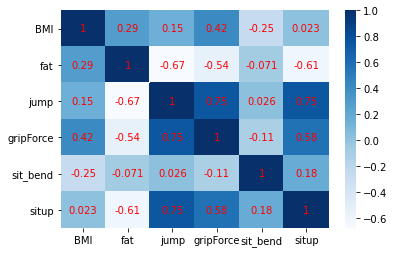

In [39]:
sns.heatmap( X_corr, annot=True, annot_kws=dict(color='r'), cmap='Blues' )

In [40]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()

>> #### 1-b) BMI v. Body Performance 

In [41]:
corr_order2 = X_corr.loc[:, 'BMI'].abs().sort_values(ascending=False)
corr_order2

BMI          1.000000
gripForce    0.415636
fat          0.288373
sit_bend     0.249520
jump         0.151664
situp        0.022758
Name: BMI, dtype: float64

In [42]:
lr = LinearRegression()
def BMI_affects( y_col_name ):
    lr = LinearRegression()

    x_train = X_train[['BMI']]
    y_train = X_train[y_col_name]
    lr.fit( x_train, y_train  )

    x_test = X_test[['BMI']]
    y_test = X_test[y_col_name]
    score = lr.score( x_test, y_test)
    return( score )

In [43]:
BMI_affects( 'gripForce' )

0.17133326594133802

In [44]:
lr = LinearRegression()
x_train = X_train[['BMI']]
y_train = X_train['gripForce']
lr.fit( x_train, y_train  )

x_test = X_test[['BMI']]
y_test = X_test['gripForce']

print("coefficient of determination : ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

coefficient of determination :  0.17133326594133802
coefficient:  [0.41654518] , y intercept:  -0.0008112650640577136


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='BMI', ylabel='gripForce'>

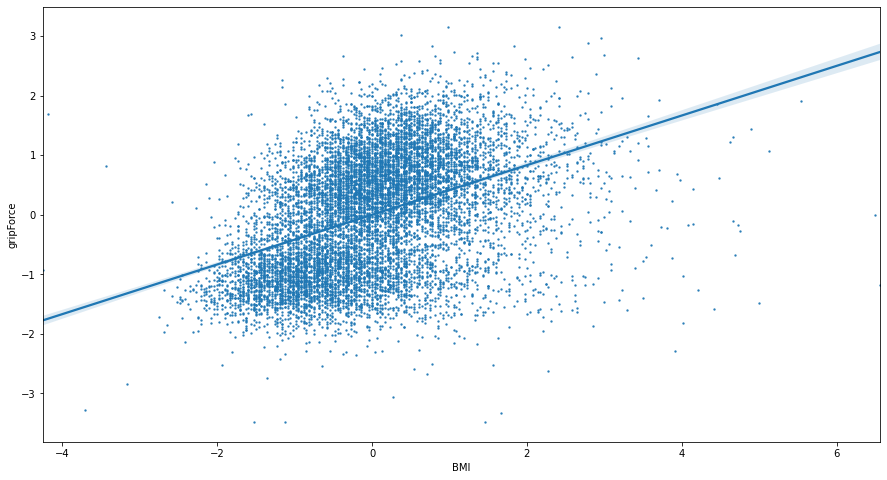

In [45]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train,scatter_kws={'s':2}, ci = 95)


In [46]:
BMI_affects( 'sit_bend' )

0.06978530635834634

In [47]:
BMI_affects( 'jump' )

0.022275144990239415

In [48]:
BMI_affects( 'situp' )

0.0006451266605943529

>> #### 1-c) Body Fat v. Body Performance

In [49]:
corr_order2 = X_corr.loc[:, 'fat'].abs().sort_values(ascending=False)
corr_order2

fat          1.000000
jump         0.673273
situp        0.608912
gripForce    0.541788
BMI          0.288373
sit_bend     0.071225
Name: fat, dtype: float64

In [50]:
def BodyFat_affects( y_col_name ):
    lr = LinearRegression()

    x_train = X_train[['fat']]
    y_train = X_train[y_col_name]
    lr.fit( x_train, y_train  )

    x_test = X_test[['fat']]
    y_test = X_test[y_col_name]
    score = lr.score( x_test, y_test)
    return( score )

In [51]:
BodyFat_affects( 'jump' )

0.43586526245488943

In [52]:
lr = LinearRegression()
x_train = X_train[['fat']]
y_train = X_train['jump']
lr.fit( x_train, y_train  )

x_test = X_test[['fat']]
y_test = X_test['jump']

print("test score: ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

test score:  0.43586526245488943
coefficient:  [-0.67753371] , y intercept:  0.0031329890889602134


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='fat', ylabel='jump'>

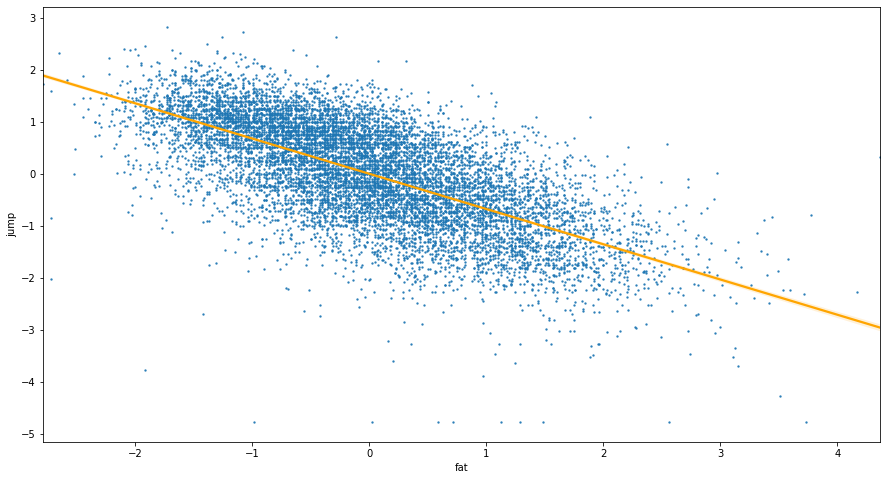

In [53]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train, line_kws = {'color': 'orange'},scatter_kws={'s':2}, ci = 95)


In [54]:
BodyFat_affects( 'situp' )

0.3470619196319803

In [55]:
lr = LinearRegression()
x_train = X_train[['fat']]
y_train = X_train['situp']
lr.fit( x_train, y_train  )

x_test = X_test[['fat']]
y_test = X_test['situp']

print("test score: ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

test score:  0.3470619196319803
coefficient:  [-0.61724341] , y intercept:  0.00011685440888610076


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='fat', ylabel='situp'>

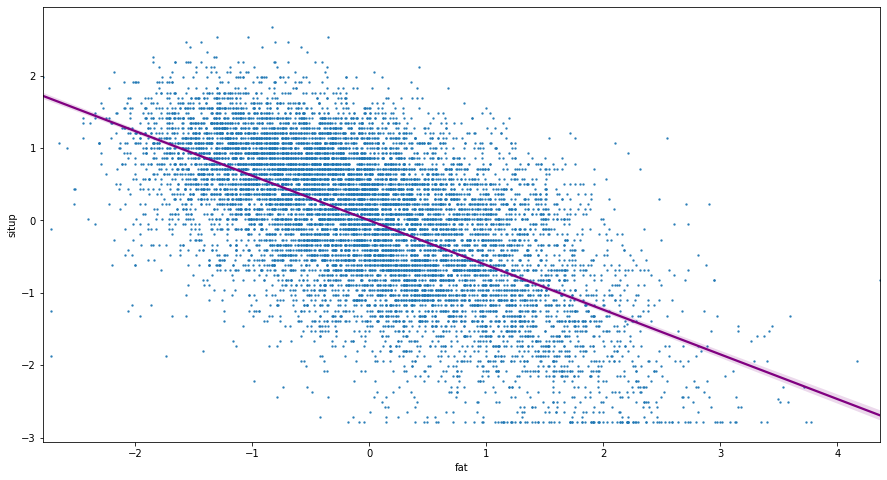

In [56]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train, line_kws = {'color': 'purple'},scatter_kws={'s':2}, ci = 95)

In [57]:
BodyFat_affects( 'gripForce' )

0.2805147536509066

In [58]:
lr = LinearRegression()
x_train = X_train[['fat']]
y_train = X_train['gripForce']
lr.fit( x_train, y_train  )

x_test = X_test[['fat']]
y_test = X_test['gripForce']

print("test score: ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

test score:  0.2805147536509066
coefficient:  [-0.54703564] , y intercept:  -0.004708342559673161


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='fat', ylabel='gripForce'>

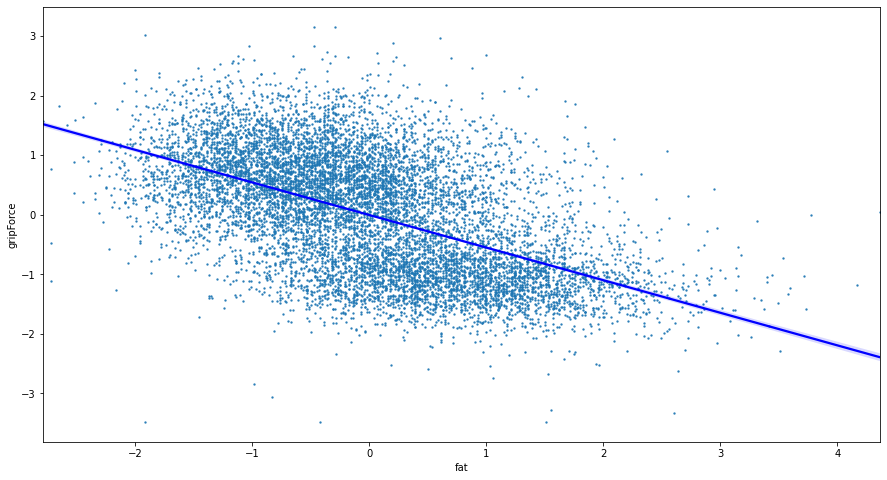

In [59]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train, line_kws = {'color': 'blue'},scatter_kws={'s':2}, ci = 95)


In [60]:
BodyFat_affects('sit_bend')

0.006857317842879906

> ##### 2) BMI is positively related to Blood Pressure(Systolic, Diastolic)

In [61]:
lr = LinearRegression()

x_train = X_train[['systolic', 'diastolic']]
y_train = X_train['BMI']
lr.fit( x_train, y_train  )

x_test = X_test[['systolic', 'diastolic']]
y_test = X_test['BMI']

print("r^2 score of BMI vs BP model is :", lr.score( x_test, y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

r^2 score of BMI vs BP model is : 0.11393365926561161
coefficient:  [0.26438831 0.07927544] , y intercept:  -0.002880304737806723


In [62]:
# Visualization of BMI vs BP
px.scatter(x_train, y_train)

>> #### 2-b BMI v. Systolic Blood Pressure

In [63]:
# correlation between BMI v. Systolic Blood Pressure
X_train['BMI'].corr( X_train['systolic'])

0.31835653441389805

In [64]:
## Visualization
bmi=X_train['BMI']
sbp=X_train['systolic']
px.scatter(bmi,sbp)


In [65]:
lr = LinearRegression()
x_train = X_train[['BMI']]
y_train = X_train['systolic']
lr.fit( x_train, y_train  )

x_test = X_test[['BMI']]
y_test = X_test['systolic']

print("r2 score: ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

r2 score:  0.11022965359009618
coefficient:  [0.31910033] , y intercept:  0.00019764696560143865


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='BMI', ylabel='systolic'>

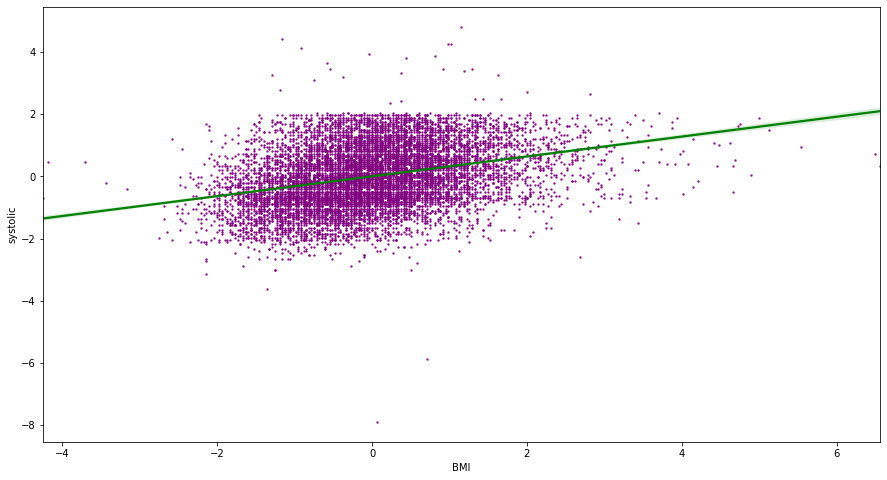

In [66]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train, line_kws = {'color': 'green'},scatter_kws={'s':2, 'color':'purple'}, ci = 95)


>> #### 2-c BMI v. Diastolic Blood Pressure

In [67]:
# Correlaion between BMI v. Diastolic
X_train['BMI'].corr( X_train['diastolic'])

0.2576607836385281

In [68]:
bmi=X_train['BMI']
dbp=X_train['diastolic']
px.scatter(bmi,dbp)

In [69]:
lr = LinearRegression()
x_train = X_train[['BMI']]
y_train = X_train['diastolic']
lr.fit( x_train, y_train  )

x_test = X_test[['BMI']]
y_test = X_test['diastolic']

print("test score: ", lr.score(x_test,y_test))
print("coefficient: ", lr.coef_, ", y intercept: ", lr.intercept_)

test score:  0.07509530589527658
coefficient:  [0.25755036] , y intercept:  0.003104008263728337


/Users/joellecho/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='BMI', ylabel='diastolic'>

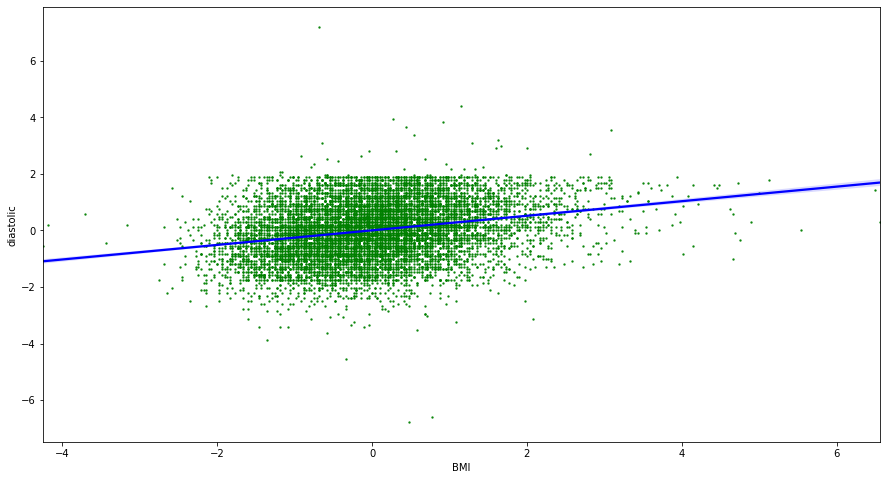

In [70]:
# Data Visualization with linear regression line 
plt.figure(figsize=(15,8))
sns.regplot(x_train,y_train, line_kws = {'color': 'blue'},scatter_kws={'s':2, 'color': 'green'}, ci = 95)


## Conclusion

1) Predict the Body Performance based on the observed data
- PCA results; CLASS(A,B,C,D) are not distinctive
-  KNN model accuracy; 63% accuracy

2) Predict Body Performance Ability based on Physical Condition
- Correlation; up to 67% 
- Linear Regression Model; Coefficient of Determination: < 0.50 

3) Predict the blood pressure level based on BMI level 
- Correlation; up to 32%
- Linear Regression Model; Coefficient of Determination : 0.11
- Would be better if I used another algorithm to predict


>KSPF needs to upgrade their Class Determining system, since neither the classes are distinctive, nor the standard of classification is explicit.


# References

> https://www.kaggle.com/datasets/kukuroo3/body-performance-data

> Ranasinghe, C., Gamage, P., Katulanda, P. et al. Relationship between Body mass index (BMI) and body fat percentage, estimated by bioelectrical impedance, in a group of Sri Lankan adults: a cross sectional study. BMC Public Health 13, 797 (2013). https://doi.org/10.1186/1471-2458-13-797

> Linderman GC, Lu J, Lu Y, et al. Association of Body Mass Index With Blood Pressure Among 1.7 Million Chinese Adults. JAMA Netw Open. 2018;1(4):e181271. doi:10.1001/jamanetworkopen.2018.1271

> Shen, S., Li, J., Guo, Q., Zhang, W., Wang, X., Fu, L., Li, L., An, Y., Liu, W., Li, H., Huang, T., Zhang, Z., & Niu, K. (2015). Body mass index is associated with physical performance in suburb-dwelling older chinese: a cross-sectional study. PloS one, 10(3), e0119914. https://doi.org/10.1371/journal.pone.0119914
	
> NSCA's Guide to Tests and Assessments. (2017, June 1). Sport Performance and Body Composition. D. https://www.nsca.com/education/articles/kinetic-select/sport-performance-and-body-composition/#:%7E:text=Reduced%20nonessential%20body%20fat%20contributes,of%20contraction%20per%20given%20workload.

